# Imports

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from matplotlib import animation
from IPython import display
from keras.callbacks import ModelCheckpoint
import torch
import torch.nn as nn
import torch.optim as optim
from torch import Tensor
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader
!pip install /kaggle/input/torchsummary/torchsummary-1.5.1-py3-none-any.whl
from torchsummary import summary

Processing /kaggle/input/torchsummary/torchsummary-1.5.1-py3-none-any.whl


# Preprocessing Utilites

In [3]:
data_dir: str = '/kaggle/input/google-research-identify-contrails-reduce-global-warming'

In [4]:
df_train_idx = pd.DataFrame({'idx': os.listdir('/kaggle/input/google-research-identify-contrails-reduce-global-warming/train')})
df_validation_idx = pd.DataFrame({'idx': os.listdir('/kaggle/input/google-research-identify-contrails-reduce-global-warming/validation')})
df_test_idx = pd.DataFrame({'idx': os.listdir('/kaggle/input/google-research-identify-contrails-reduce-global-warming/test')})

In [5]:
def get_band_images(idx: str, parrent_folder: str, band: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, f'band_{band}.npy'))

In [6]:
_T11_BOUNDS = (243, 303)
_CLOUD_TOP_TDIFF_BOUNDS = (-4, 5)
_TDIFF_BOUNDS = (-4, 2)

def normalize_range(data, bounds):
    """Maps data to the range [0, 1]."""
    return (data - bounds[0]) / (bounds[1] - bounds[0])


def get_ash_color_images(idx: str, parrent_folder: str, get_mask_frame_only=False) -> np.array:
    band11 = get_band_images(idx, parrent_folder, '11')
    band14 = get_band_images(idx, parrent_folder, '14')
    band15 = get_band_images(idx, parrent_folder, '15')
    
    if get_mask_frame_only:
        band11 = band11[:,:,4]
        band14 = band14[:,:,4]
        band15 = band15[:,:,4]

    r = normalize_range(band15 - band14, _TDIFF_BOUNDS)
    g = normalize_range(band14 - band11, _CLOUD_TOP_TDIFF_BOUNDS)
    b = normalize_range(band14, _T11_BOUNDS)
    false_color = np.clip(np.stack([r, g, b], axis=2), 0, 1)
    return false_color

In [7]:
def get_mask_image(idx: str, parrent_folder: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, 'human_pixel_masks.npy')) 

# EDA

In [8]:
train_images_with_contrails = 0
train_images_without_contrails = 0
train_contrail_pixel_count = 0
train_non_contrail_pixel_count = 0
train_contrail_pixel_count_conly = 0
train_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_train_idx['idx']:
    mask = get_mask_image(idx, 'train')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        train_images_with_contrails += 1
        train_contrail_pixel_count_conly += contrail_pixel_count
        train_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        train_images_without_contrails += 1
        
    train_contrail_pixel_count += contrail_pixel_count
    train_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

In [9]:
validation_images_with_contrails = 0
validation_images_without_contrails = 0
validation_contrail_pixel_count = 0
validation_non_contrail_pixel_count = 0
validation_contrail_pixel_count_conly = 0
validation_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_validation_idx['idx']:
    mask = get_mask_image(idx, 'validation')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        validation_images_with_contrails += 1
        validation_contrail_pixel_count_conly += contrail_pixel_count
        validation_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        validation_images_without_contrails += 1
        
    validation_contrail_pixel_count += contrail_pixel_count
    validation_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

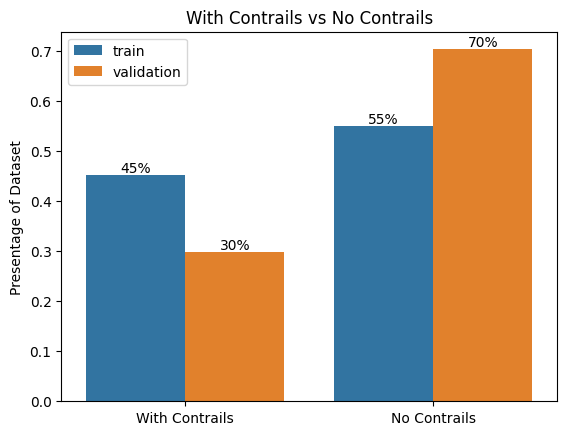

In [10]:
train_with_contrails = train_images_with_contrails / (train_images_with_contrails + train_images_without_contrails)
train_without_contrails = train_images_without_contrails / (train_images_with_contrails + train_images_without_contrails)
validation_with_contrails = validation_images_with_contrails / (validation_images_with_contrails + validation_images_without_contrails)
validation_without_contrails = validation_images_without_contrails / (validation_images_with_contrails + validation_images_without_contrails)
data = pd.DataFrame({'Type': ['With Contrails', 'No Contrails', 'With Contrails', 'No Contrails'],
        'Data': [train_with_contrails, train_without_contrails, validation_with_contrails, validation_without_contrails],
        'Data Set': ['train', 'train', 'validation', 'validation']})

ax = sns.barplot(data=data, y='Data', x="Type", hue="Data Set", orient='v')

for p in ax.patches:
    ax.annotate(format(p.get_height() * 100, '.0f') + '%',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
    
ax.set_xlabel('')
ax.set_ylabel('Presentage of Dataset')
ax.set_title('With Contrails vs No Contrails')

plt.legend()
plt.show()

There is a significantly higher percentage of images with contrails in the train dataset than in the validation.

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

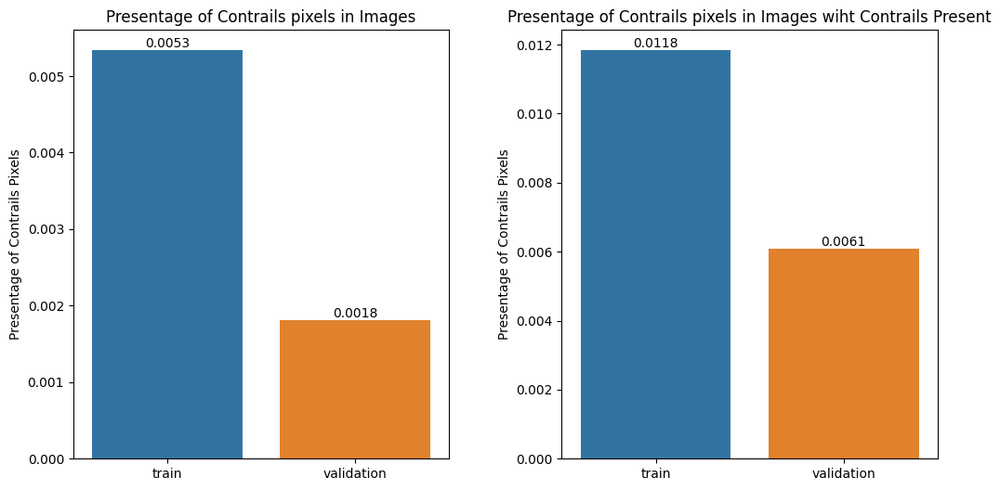

In [11]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
fig.subplots_adjust(wspace=0.3)
axes = axes.flatten()

train_with_contrails_pix = train_contrail_pixel_count / (train_contrail_pixel_count + train_non_contrail_pixel_count)
validation_with_contrails_pix = validation_contrail_pixel_count / (validation_contrail_pixel_count + validation_non_contrail_pixel_count)
data = pd.DataFrame({'Data': [train_with_contrails_pix, validation_with_contrails_pix],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[0])
for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[0].set_xlabel('')
axes[0].set_ylabel('Presentage of Contrails Pixels')
axes[0].set_title('Presentage of Contrails pixels in Images')

train_with_contrails_pix_conly = train_contrail_pixel_count_conly / (train_contrail_pixel_count_conly + train_non_contrail_pixel_count_conly)
validation_with_contrails_pix_conly = validation_contrail_pixel_count_conly / (validation_contrail_pixel_count_conly + validation_non_contrail_pixel_count_conly)
data = pd.DataFrame({'Data': [train_with_contrails_pix_conly, validation_with_contrails_pix_conly],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[1])
for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[1].set_xlabel('')
axes[1].set_ylabel('Presentage of Contrails Pixels')
axes[1].set_title('Presentage of Contrails pixels in Images wiht Contrails Present')

plt.show()

There is a significant imbalance in the number of pixels between the negative class (non-contrail) and the positive class (contrail). In the training and validation datasets, the ratio of negative to positive class pixels is 85:1 and 164:1 respectively. This severe class imbalance can lead to biased models that prioritize the majority class, ultimately reducing the overall prediction quality.

To address this issue, we can employ two strategies: optimizing the confidence threshold during post-processing or incorporating class weights into the loss function during training.

Optimizing confidence threshold during post-processing:
After training the model, we can adjust the confidence threshold used to determine class predictions. By carefully selecting the threshold, we can increase the sensitivity to the positive class, thereby improving the detection of contrails. This approach allows us to fine-tune the model's predictions without retraining it.

Adding class weights to the loss function during training:
Another way to handle the class imbalance is by assigning appropriate weights to the different classes during model training. By assigning higher weights to the minority class (contrail), we can increase its influence on the loss function. This adjustment ensures that the model pays more attention to the positive class and helps mitigate the bias towards the majority class (non-contrail).

This notebook will utilize both strategies.

Additionally, I thought it was worth pointing out that there are significantly lass contrails in the validation images than in the train images.

In [12]:
def show_band_images(idx: str, parrent_folder: str, band: str):
    data = get_band_images(idx, parrent_folder, band)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_images(idx: str, parrent_folder: str):
    data = get_ash_color_images(idx, parrent_folder)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_frame(idx: str, parrent_folder: str, frame: int):
    data = get_ash_color_images(idx, parrent_folder)
    plt.imshow(data[:,:,:,frame])
    plt.show()
    
def show_mask_image(idx: str, parrent_folder: str):
    plt.imshow(get_mask_image(idx, parrent_folder))
    plt.show()

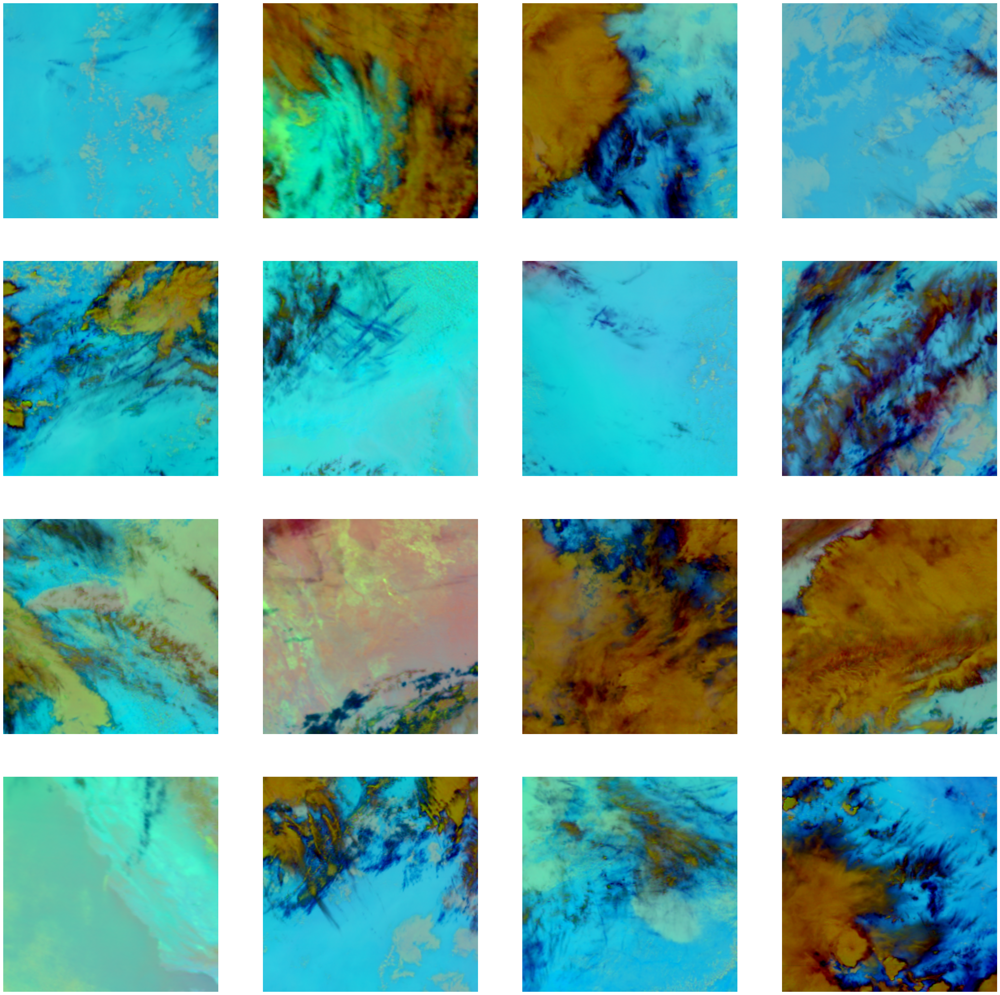

In [13]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(40, 40))
axes = axes.flatten()

for i in range(len(axes)):
    images = get_ash_color_images(str(df_train_idx.iloc[730 + i]['idx']), 'train')
    axes[i].imshow(images[:,:,:,4])
    axes[i].axis('off')

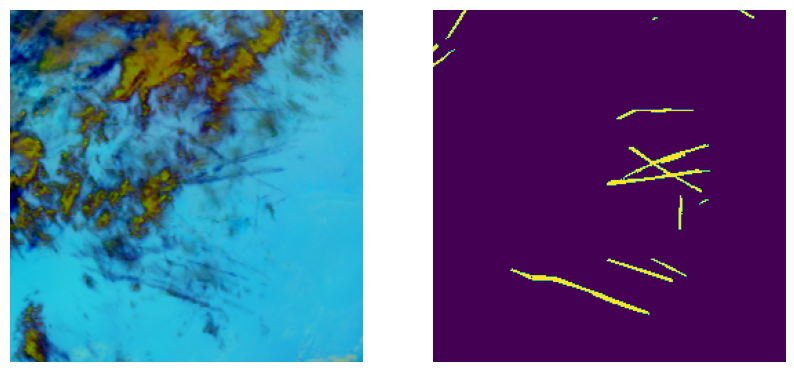

In [14]:
images = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
axes = axes.flatten()

axes[0].imshow(images[:,:,:,4])
axes[0].axis('off')
axes[1].imshow(get_mask_image(str(df_train_idx.iloc[683]['idx']), 'train'))
axes[1].axis('off')

plt.show()

In [15]:
false_color = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
# Animation
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_axis_off()
im = plt.imshow(false_color[..., 0])
def draw(i):
    im.set_array(false_color[..., i])
    return [im]
anim = animation.FuncAnimation(
    fig, draw, frames=false_color.shape[-1], interval=500, blit=True
)
plt.close()
display.HTML(anim.to_jshtml())

# Model unet


In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [17]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])

        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class SimpleUNet(nn.Module):
    def __init__(self):
        super(SimpleUNet, self).__init__()
        # Giảm số lớp và số kênh
        self.inc = DoubleConv(24, 32)
        self.down1 = Down(32, 64)
        self.up1 = Up(96, 32)
        self.outc = nn.Conv2d(32, 1, kernel_size=1)



    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x = self.up1(x2, x1)
        x = self.outc(x)
        return x
summary(SimpleUNet().to(device), input_size=(24, 256, 256))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 256, 256]           6,944
       BatchNorm2d-2         [-1, 32, 256, 256]              64
              ReLU-3         [-1, 32, 256, 256]               0
            Conv2d-4         [-1, 32, 256, 256]           9,248
       BatchNorm2d-5         [-1, 32, 256, 256]              64
              ReLU-6         [-1, 32, 256, 256]               0
        DoubleConv-7         [-1, 32, 256, 256]               0
         MaxPool2d-8         [-1, 32, 128, 128]               0
            Conv2d-9         [-1, 64, 128, 128]          18,496
      BatchNorm2d-10         [-1, 64, 128, 128]             128
             ReLU-11         [-1, 64, 128, 128]               0
           Conv2d-12         [-1, 64, 128, 128]          36,928
      BatchNorm2d-13         [-1, 64, 128, 128]             128
             ReLU-14         [-1, 64, 1

# Model Resnet50


In [18]:
import torch
import torch.nn as nn
from torchsummary import summary

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(ResidualBlock, self).__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.downsample = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.downsample = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        residual = self.downsample(x)

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)

        out += residual
        out = self.relu(out)

        return out


class ResNet50Segmentation(nn.Module):
    def __init__(self, in_channels=24, num_classes=1):
        super(ResNet50Segmentation, self).__init__()

        # Initial convolutional layer
        self.conv1 = nn.Conv2d(in_channels, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # Residual blocks
        self.layer1 = self._make_layer(64, 64, 3)
        self.layer2 = self._make_layer(64, 128, 4, stride=2)
        self.layer3 = self._make_layer(128, 256, 6, stride=2)
        self.layer4 = self._make_layer(256, 512, 3, stride=2)

        # Final convolutional layer
        self.conv_out = nn.Conv2d(512, num_classes, kernel_size=1)

        # Upsample layer
        self.upsample = nn.Upsample(scale_factor=32, mode='bilinear', align_corners=True)

    def _make_layer(self, in_channels, out_channels, blocks, stride=1):
        layers = []
        layers.append(ResidualBlock(in_channels, out_channels, stride))
        for _ in range(1, blocks):
            layers.append(ResidualBlock(out_channels, out_channels))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        # Remove AdaptiveAvgPool2d and add a Conv2d layer
        x = self.conv_out(x)

        # Upsample the output
        x = self.upsample(x)

        return x


# Display the summary of the modified ResNet-50 model
summary(ResNet50Segmentation().to(device), input_size=(24, 256, 256))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]          75,264
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
    ResidualBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14           [-1, 64,

# Model VGG19

In [19]:
import torch
import torch.nn as nn
from torchsummary import summary
from torch.nn.functional import interpolate

class VGG19Segmentation(nn.Module):
    def __init__(self, in_channels=24, num_classes=1):
        super(VGG19Segmentation, self).__init__()

        # Define the VGG19 architecture
        self.features = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),

            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )

        # Additional convolutional layer for segmentation output
        self.segmentation_output = nn.Conv2d(512, num_classes, kernel_size=1)

    def forward(self, x):
        x = self.features(x)
        x = interpolate(x, size=(256, 256), mode='bilinear', align_corners=False)
        x = self.segmentation_output(x)
        return x



# Create an instance of the model
model = VGG19Segmentation().to(device)

# Display the summary of the model
summary(model, input_size=(24, 256, 256))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]          13,888
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
         MaxPool2d-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
        MaxPool2d-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
             ReLU-14          [-1, 256,

# Trainer

In [20]:
class Dice(nn.Module):
    def __init__(self, use_sigmoid=True):
        super(Dice, self).__init__()
        self.sigmoid = nn.Sigmoid()
        self.use_sigmoid = use_sigmoid

    def forward(self, inputs, targets, smooth=1):
        if self.use_sigmoid:
            inputs = self.sigmoid(inputs)       
        
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()
        dice = (2.0 *intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return dice
    
dice = Dice()

In [21]:
class MyTrainer:
    def __init__(self, model, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            callbacks=None
            ):
        if callbacks is None:
            callbacks = []
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            for i, data in enumerate(train_dataloader):
                self.model.train()
                if i % 100 == 0:
                    print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
                    sub_batch_losses.clear()
                # Every data instance is an input + label pair
                images, mask = data
                
                if torch.cuda.is_available():
                    images = images.cuda()
                    mask = mask.cuda()

                # Zero your gradients for every batch!
                self.optimizer.zero_grad()
                # Make predictions for this batch
                outputs = self.model(images)
                # Compute the loss and its gradients
                loss = self.loss_fn(outputs, mask)
                loss.backward()
                # Adjust learning weights
                self.optimizer.step()

                # Saves data
                self.batch_losses.append(loss.item())
                batch_losses.append(loss)
                sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
                for callback in callbacks:
                    callback.on_epoch_end(e, self.model, self.validation_losses)
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(test_dataloader):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        loss = self.loss_fn(output, mask)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

# Dataset

In [22]:
class ContrailsAshDataset(torch.utils.data.Dataset):
    def __init__(self, parrent_folder: str):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/kaggle/input/google-research-identify-contrails-reduce-global-warming/{parrent_folder}')})
        self.parrent_folder: str = parrent_folder

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: str = str(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(image_id, self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        mask = torch.tensor(get_mask_image(image_id, self.parrent_folder)).to(torch.float32).permute(2, 0, 1)
        return images, mask

In [23]:
dataset_train = ContrailsAshDataset('train')
dataset_validation = ContrailsAshDataset('validation')

data_loader_train = DataLoader(dataset_train, batch_size=16, shuffle=True, num_workers=2)
data_loader_validation = DataLoader(dataset_validation, batch_size=16, shuffle=True, num_workers=2)

In [24]:
img, label = next(iter(data_loader_train))
img.shape, label.shape

(torch.Size([16, 24, 256, 256]), torch.Size([16, 1, 256, 256]))

# Train unet

In [25]:
train = True

In [26]:
checkpoint_callback_unet = ModelCheckpoint('best_model_unet.h5', 
                                           monitor='val_loss', 
                                           save_best_only=True,
                                           mode='min',
                                           verbose=1)

In [27]:
if train:
    model = SimpleUNet()
    model.to(device)
    
    criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
    optimizer = optim.Adam(model.parameters(), lr=0.01)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

    num_epochs = 10

    trainer_unet = MyTrainer(model, optimizer, criterion, lr_scheduler)
    trainer_unet.fit(data_loader_train, data_loader_validation, epochs=num_epochs)
else:
    model = SimpleUNet()
    model.load_state_dict(torch.load('/kaggle/input/contrails-unet-pretrained/unet.pt'))
    model.eval()
    model.to(device)

New learning rate: [0.01]
epotch: 0 batch: 0/1284 loss: nan
epotch: 0 batch: 100/1284 loss: 0.9181509613990784
epotch: 0 batch: 200/1284 loss: 0.7437284588813782
epotch: 0 batch: 300/1284 loss: 0.6081613898277283
epotch: 0 batch: 400/1284 loss: 0.5869746208190918
epotch: 0 batch: 500/1284 loss: 0.5656396746635437
epotch: 0 batch: 600/1284 loss: 0.5662856698036194
epotch: 0 batch: 700/1284 loss: 0.5214970111846924
epotch: 0 batch: 800/1284 loss: 0.515372633934021
epotch: 0 batch: 900/1284 loss: 0.5231376886367798
epotch: 0 batch: 1000/1284 loss: 0.5318247675895691
epotch: 0 batch: 1100/1284 loss: 0.4747101664543152
epotch: 0 batch: 1200/1284 loss: 0.4733707308769226
Train Epoch: 0 Average Loss: 0.577504
Validation loss after 1 epochs was 0.33
New learning rate: [0.006999999999999999]
epotch: 1 batch: 0/1284 loss: nan
epotch: 1 batch: 100/1284 loss: 0.46588924527168274
epotch: 1 batch: 200/1284 loss: 0.4634038805961609
epotch: 1 batch: 300/1284 loss: 0.4237980544567108
epotch: 1 batch: 4

# Train Resnet50

In [28]:
class MyTrainer_rn:
    def __init__(self, model_rn, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model_rn
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            callbacks=None
            ):
        if callbacks is None:
            callbacks = []
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            for i, data in enumerate(train_dataloader):
                self.model.train()
                if i % 100 == 0:
                    print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
                    sub_batch_losses.clear()
                # Every data instance is an input + label pair
                images, mask = data
                
                if torch.cuda.is_available():
                    images = images.cuda()
                    mask = mask.cuda()

                # Zero your gradients for every batch!
                self.optimizer.zero_grad()
                # Make predictions for this batch
                outputs = self.model(images)
                # Compute the loss and its gradients
                loss = self.loss_fn(outputs, mask)
                loss.backward()
                # Adjust learning weights
                self.optimizer.step()

                # Saves data
                self.batch_losses.append(loss.item())
                batch_losses.append(loss)
                sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
                for callback in callbacks:
                    callback.on_epoch_end(e, self.model, self.validation_losses)
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(test_dataloader):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        loss = self.loss_fn(output, mask)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

In [29]:
checkpoint_callback_resnet = ModelCheckpoint('best_model_resnet.h5', 
                                             monitor='val_loss', 
                                             save_best_only=True,
                                             mode='min',
                                             verbose=1)

In [30]:

model_rn = ResNet50Segmentation()
model_rn.to(device)

criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
optimizer = optim.Adam(model_rn.parameters(), lr=0.01)
lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

num_epochs = 10

trainer_rn = MyTrainer_rn(model_rn, optimizer, criterion, lr_scheduler)
trainer_rn.fit(data_loader_train, data_loader_validation, epochs=num_epochs)

New learning rate: [0.01]
epotch: 0 batch: 0/1284 loss: nan
epotch: 0 batch: 100/1284 loss: 1.2372629642486572
epotch: 0 batch: 200/1284 loss: 0.9630304574966431
epotch: 0 batch: 300/1284 loss: 0.9341748952865601
epotch: 0 batch: 400/1284 loss: 0.9283998608589172
epotch: 0 batch: 500/1284 loss: 0.8703144192695618
epotch: 0 batch: 600/1284 loss: 0.8431259393692017
epotch: 0 batch: 700/1284 loss: 0.8759841918945312
epotch: 0 batch: 800/1284 loss: 0.8366431593894958
epotch: 0 batch: 900/1284 loss: 0.8328824639320374
epotch: 0 batch: 1000/1284 loss: 0.7910056114196777
epotch: 0 batch: 1100/1284 loss: 0.8025572299957275
epotch: 0 batch: 1200/1284 loss: 0.8201498985290527
Train Epoch: 0 Average Loss: 0.889324
Validation loss after 1 epochs was 0.658
New learning rate: [0.006999999999999999]
epotch: 1 batch: 0/1284 loss: nan
epotch: 1 batch: 100/1284 loss: 0.8298800587654114
epotch: 1 batch: 200/1284 loss: 0.7335012555122375
epotch: 1 batch: 300/1284 loss: 0.719593346118927
epotch: 1 batch: 4

# Train VGG19

In [31]:
class MyTrainer_vgg:
    def __init__(self, model_vgg, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model_vgg
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            callbacks=None
            ):
        if callbacks is None:
            callbacks = []
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            for i, data in enumerate(train_dataloader):
                self.model.train()
                if i % 100 == 0:
                    print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
                    sub_batch_losses.clear()
                # Every data instance is an input + label pair
                images, mask = data
                
                if torch.cuda.is_available():
                    images = images.cuda()
                    mask = mask.cuda()

                # Zero your gradients for every batch!
                self.optimizer.zero_grad()
                # Make predictions for this batch
                outputs = self.model(images)
                # Compute the loss and its gradients
                loss = self.loss_fn(outputs, mask)
                loss.backward()
                # Adjust learning weights
                self.optimizer.step()

                # Saves data
                self.batch_losses.append(loss.item())
                batch_losses.append(loss)
                sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
                for callback in callbacks:
                    callback.on_epoch_end(e, self.model, self.validation_losses)
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(test_dataloader):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        loss = self.loss_fn(output, mask)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

In [32]:
checkpoint_callback_vgg19 = ModelCheckpoint('best_model_vgg19.h5', 
                                            monitor='val_loss', 
                                            save_best_only=True,
                                            mode='min',
                                            verbose=1)

In [33]:
model_vgg = VGG19Segmentation()
model_vgg.to(device)

criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
optimizer = optim.Adam(model_vgg.parameters(), lr=0.01)
lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

num_epochs = 10

trainer_vgg = MyTrainer_vgg(model_vgg, optimizer, criterion, lr_scheduler)
trainer_vgg.fit(data_loader_train, data_loader_validation, epochs=num_epochs)

New learning rate: [0.01]
epotch: 0 batch: 0/1284 loss: nan
epotch: 0 batch: 100/1284 loss: 413223808.0
epotch: 0 batch: 200/1284 loss: 1.0169944763183594
epotch: 0 batch: 300/1284 loss: 0.9849808216094971
epotch: 0 batch: 400/1284 loss: 0.9865596890449524
epotch: 0 batch: 500/1284 loss: 0.9713647365570068
epotch: 0 batch: 600/1284 loss: 0.9795120358467102
epotch: 0 batch: 700/1284 loss: 0.9862340688705444
epotch: 0 batch: 800/1284 loss: 0.9802750945091248
epotch: 0 batch: 900/1284 loss: 0.9313825368881226
epotch: 0 batch: 1000/1284 loss: 0.9978379011154175
epotch: 0 batch: 1100/1284 loss: 0.9464002847671509
epotch: 0 batch: 1200/1284 loss: 0.9650042653083801
Train Epoch: 0 Average Loss: 32182540.000000
Validation loss after 1 epochs was 0.6997
New learning rate: [0.006999999999999999]
epotch: 1 batch: 0/1284 loss: nan
epotch: 1 batch: 100/1284 loss: 0.9888787865638733
epotch: 1 batch: 200/1284 loss: 0.9656897187232971
epotch: 1 batch: 300/1284 loss: 0.9689137935638428
epotch: 1 batch:

# Training Overview Unet

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

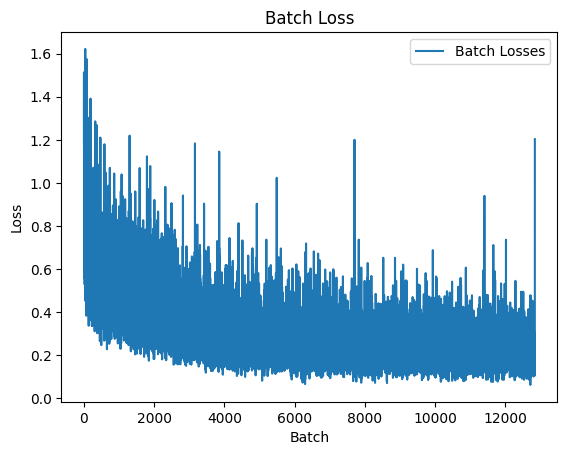

In [34]:
df_data = pd.DataFrame({'Batch Losses': trainer_unet.batch_losses})
sns.lineplot(data=df_data)
plt.xlabel('Batch')
plt.ylabel('Loss')
plt.title('Batch Loss')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

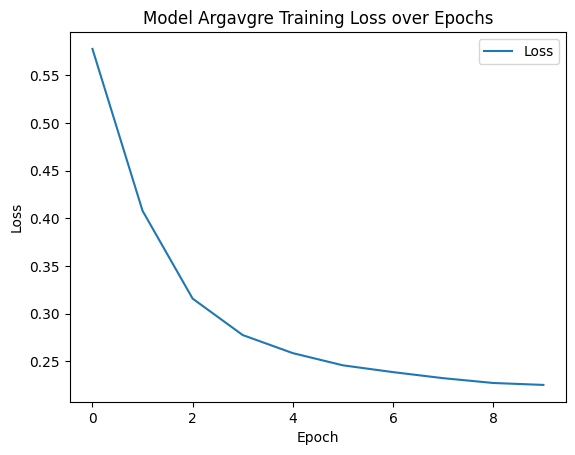

In [35]:

df_data = pd.DataFrame({'Loss': trainer_unet.epoch_losses})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Model Argavgre Training Loss over Epochs')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

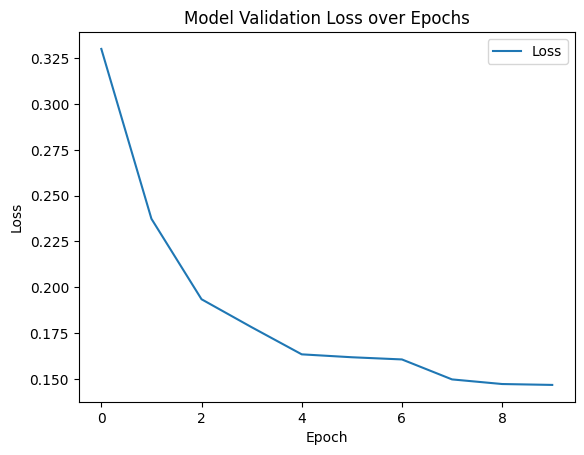

In [36]:

df_data = pd.DataFrame({'Loss': trainer_unet.validation_losses})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Model Validation Loss over Epochs')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

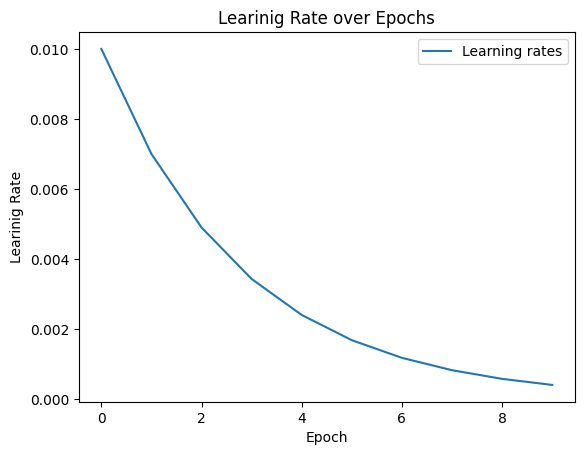

In [37]:

df_data = pd.DataFrame({'Learning rates': trainer_unet.learning_rates})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Learinig Rate')
plt.title('Learinig Rate over Epochs')
plt.show()

# Training Overview Resnet50

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

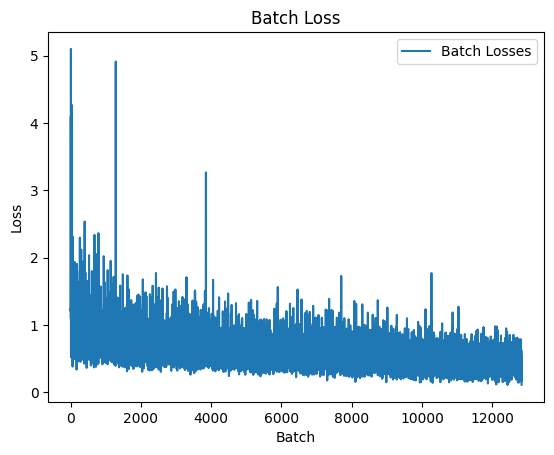

In [38]:

df_data = pd.DataFrame({'Batch Losses': trainer_rn.batch_losses})
sns.lineplot(data=df_data)
plt.xlabel('Batch')
plt.ylabel('Loss')
plt.title('Batch Loss')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

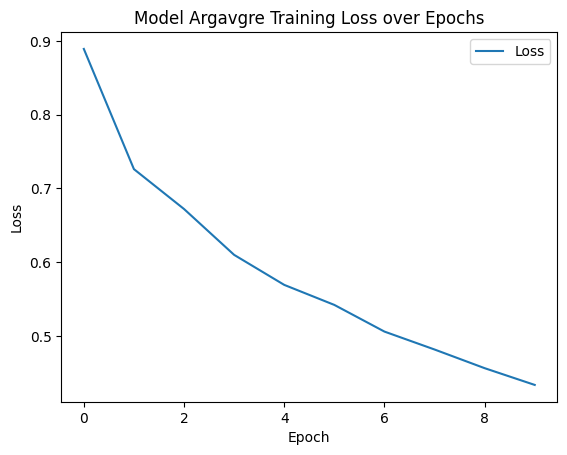

In [39]:

df_data = pd.DataFrame({'Loss': trainer_rn.epoch_losses})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Model Argavgre Training Loss over Epochs')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

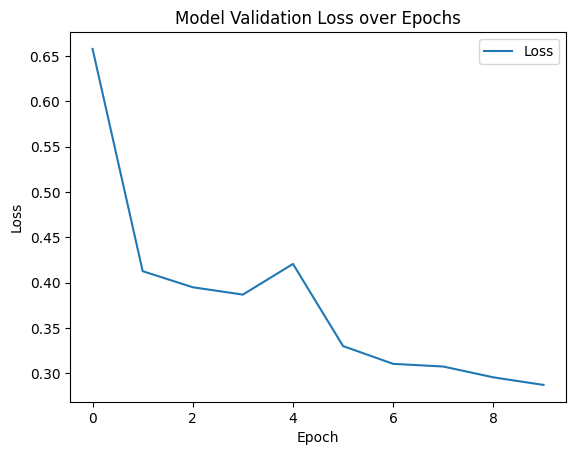

In [40]:

df_data = pd.DataFrame({'Loss': trainer_rn.validation_losses})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Model Validation Loss over Epochs')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

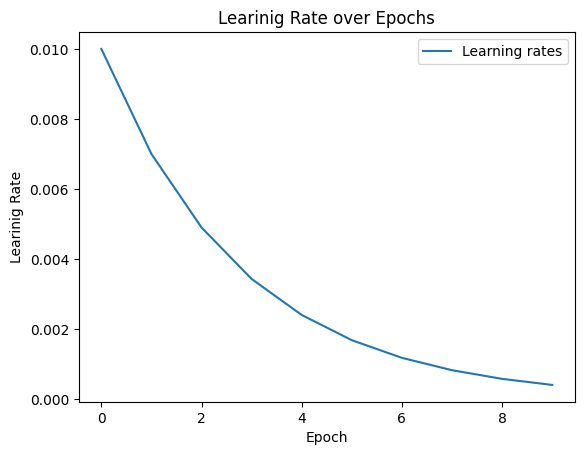

In [41]:
df_data = pd.DataFrame({'Learning rates': trainer_rn.learning_rates})

sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Learinig Rate')
plt.title('Learinig Rate over Epochs')
plt.show()

# Training Overview VGG19

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

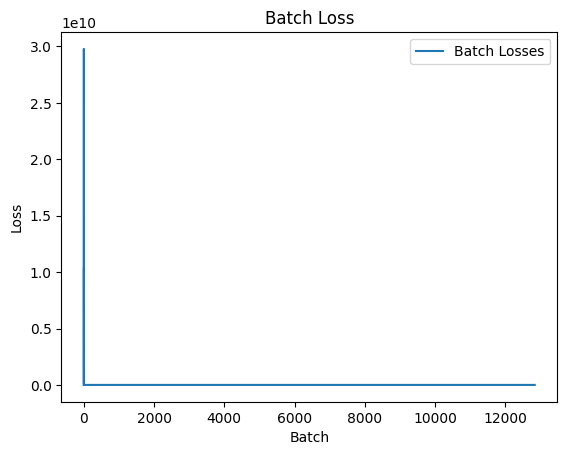

In [42]:

df_data = pd.DataFrame({'Batch Losses': trainer_vgg.batch_losses})
sns.lineplot(data=df_data)
plt.xlabel('Batch')
plt.ylabel('Loss')
plt.title('Batch Loss')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

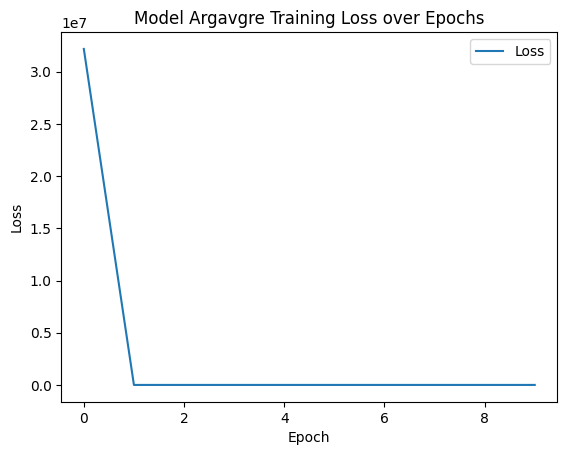

In [43]:

df_data = pd.DataFrame({'Loss': trainer_vgg.epoch_losses})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Model Argavgre Training Loss over Epochs')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

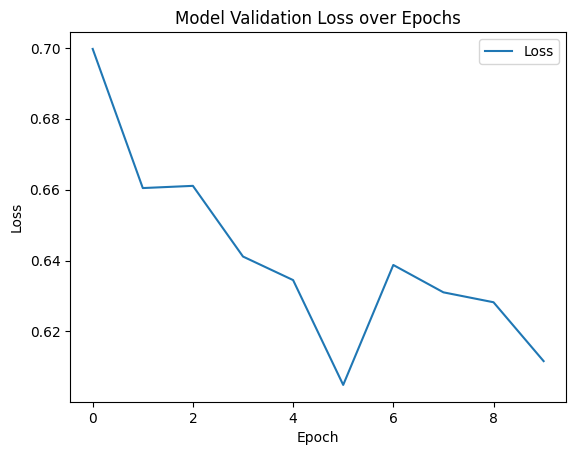

In [44]:

df_data = pd.DataFrame({'Loss': trainer_vgg.validation_losses})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Model Validation Loss over Epochs')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

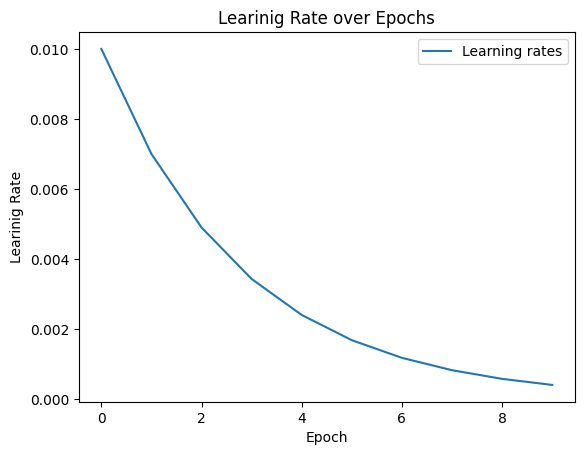

In [45]:

df_data = pd.DataFrame({'Learning rates': trainer_vgg.learning_rates})
sns.lineplot(data=df_data)
plt.xlabel('Epoch')
plt.ylabel('Learinig Rate')
plt.title('Learinig Rate over Epochs')
plt.show()

# So sánh model

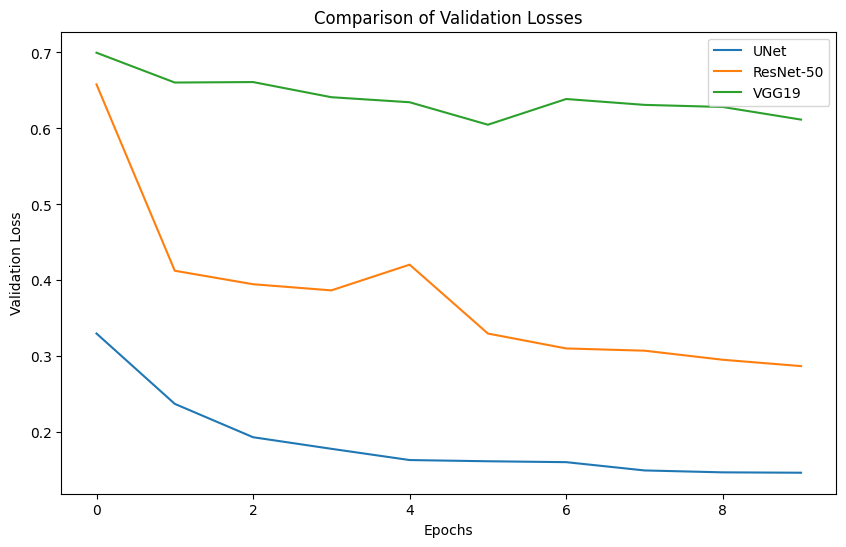

In [46]:
import matplotlib.pyplot as plt
import pandas as pd

# Tạo DataFrame từ dữ liệu của ba mô hình
df_unet = pd.DataFrame({'Loss_UNet': trainer_unet.validation_losses})
df_resnet = pd.DataFrame({'Loss_ResNet50': trainer_rn.validation_losses})
df_vgg19 = pd.DataFrame({'Loss_VGG19': trainer_vgg.validation_losses})

# Kết hợp các DataFrame thành một DataFrame duy nhất
df_data = pd.concat([df_unet, df_resnet, df_vgg19], axis=1)

# Vẽ biểu đồ
plt.figure(figsize=(10, 6))
plt.plot(df_data['Loss_UNet'], label='UNet')
plt.plot(df_data['Loss_ResNet50'], label='ResNet-50')
plt.plot(df_data['Loss_VGG19'], label='VGG19')

plt.title('Comparison of Validation Losses')
plt.xlabel('Epochs')
plt.ylabel('Validation Loss')
plt.legend()
plt.show()


# Find Optimal Threshold

In [47]:
class DiceThresholdTester:
    
    def __init__(self, model: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

## VGG Thershold

In [65]:
class DiceThresholdTester_VGG:
    
    def __init__(self, model_vgg: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model_vgg
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model_vgg.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [68]:
dice_threshold_tester_vgg = DiceThresholdTester_VGG(model_vgg, data_loader_validation)
dice_threshold_tester_vgg.precalculate_prediction()

In [69]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester_vgg.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data_vgg = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.39 with dice: 0.0038930053684368003


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_conte

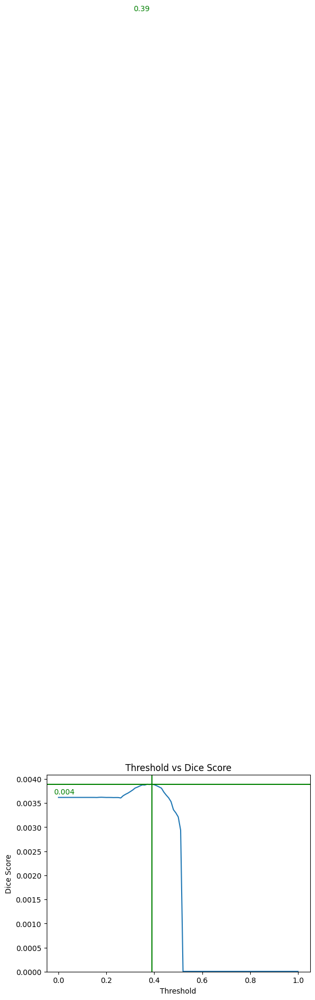

In [70]:
sns.lineplot(data=df_threshold_data_vgg, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

## Restnet Thershold

In [71]:
class DiceThresholdTester_RN:
    
    def __init__(self, model_rn: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model_rn
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model_rn.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [72]:
dice_threshold_tester_rn = DiceThresholdTester_RN(model_rn, data_loader_validation)
dice_threshold_tester_rn.precalculate_prediction()

In [73]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester_rn.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data_rn = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.88 with dice: 0.10137891706781445


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_conte

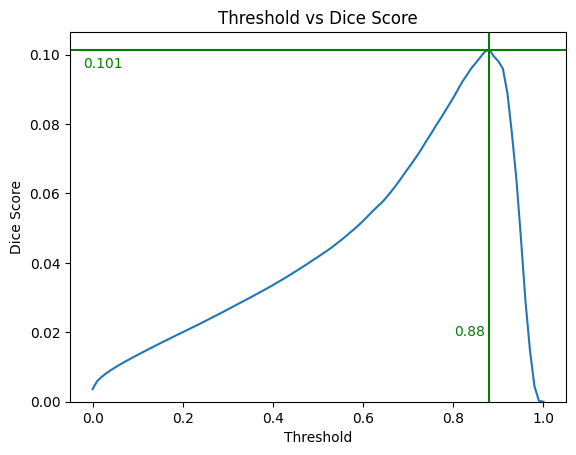

In [74]:
sns.lineplot(data=df_threshold_data_rn, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

## Unet Thershold

In [54]:
dice_threshold_tester = DiceThresholdTester(model, data_loader_validation)
dice_threshold_tester.precalculate_prediction()

In [55]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.97 with dice: 0.40475375440410405


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_conte

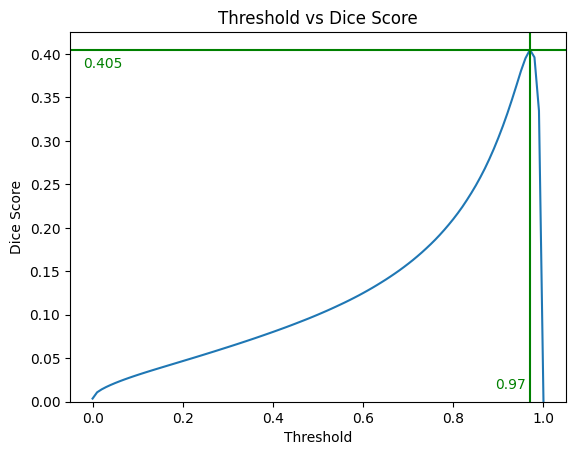

In [56]:
sns.lineplot(data=df_threshold_data, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

# Preview Models Predictions on Validation

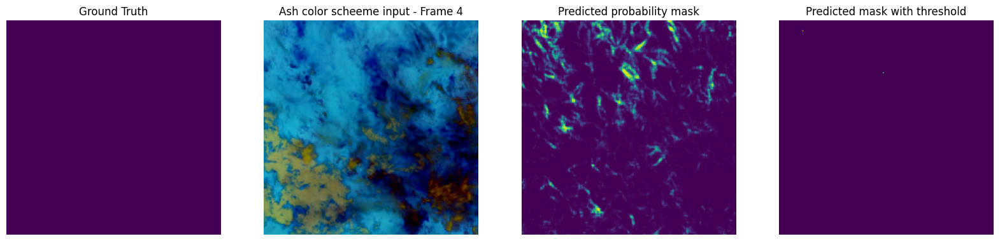

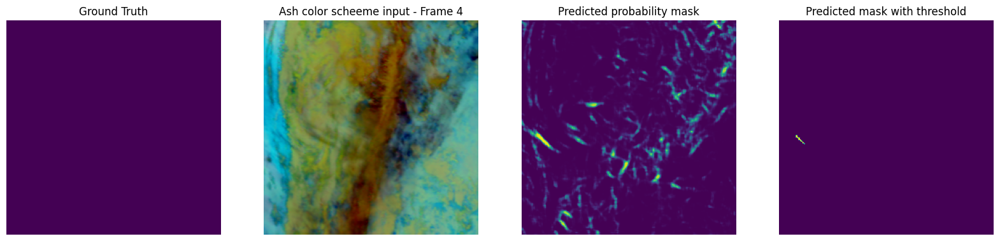

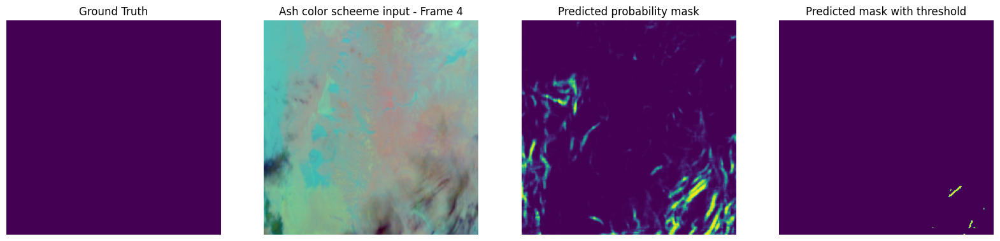

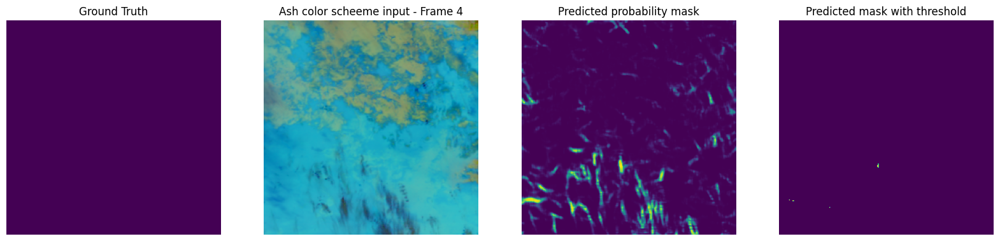

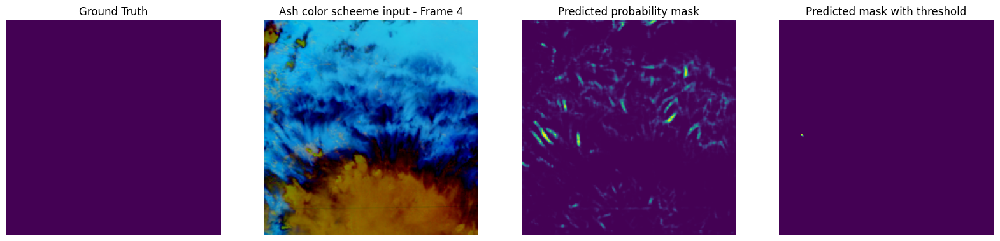

...

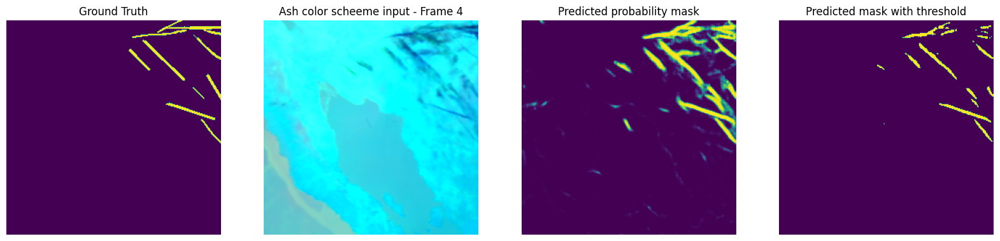

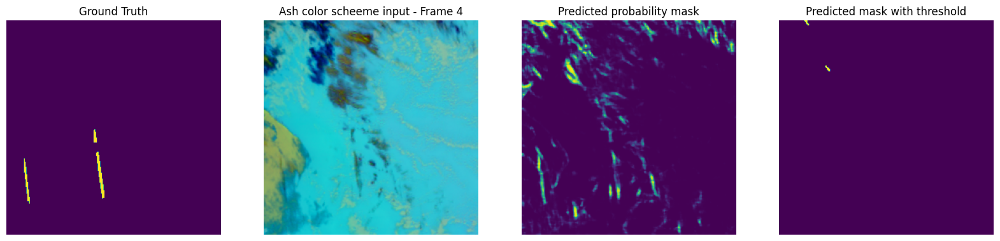

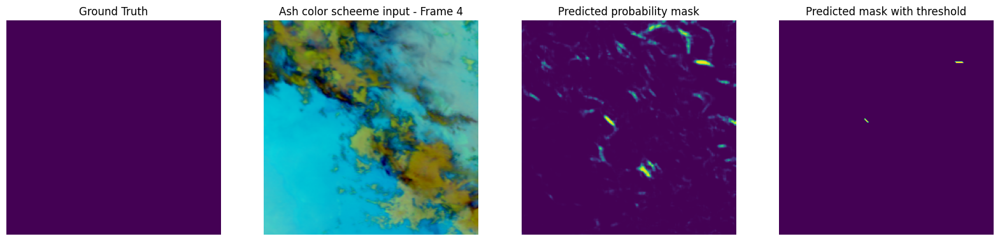

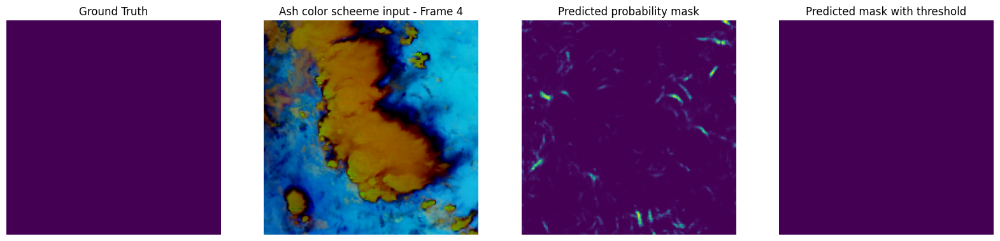

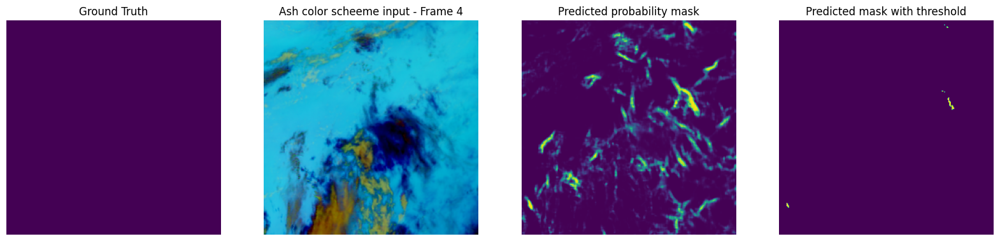

In [57]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

batches_to_show = 4
model.eval()

for i, data in enumerate(data_loader_validation):
    images, mask = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    images = images.cpu()
        
    for img_num in range(0, images.shape[0]):
        fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,10))
        axes = axes.flatten()
        
        # Show groud trought 
        axes[0].imshow(mask[img_num, 0, :, :])
        axes[0].axis('off')
        axes[0].set_title('Ground Truth')
        
        # Show ash color scheme input image
        axes[1].imshow( np.concatenate(
            (
            np.expand_dims(images[img_num, 4, :, :], axis=2),
            np.expand_dims(images[img_num, 12, :, :], axis=2),
            np.expand_dims(images[img_num, 20, :, :], axis=2)
        ), axis=2))
        axes[1].axis('off')
        axes[1].set_title('Ash color scheeme input - Frame 4')

        # Show predicted mask
        axes[2].imshow(predicated_mask[img_num, 0, :, :], vmin=0, vmax=1)
        axes[2].axis('off')
        axes[2].set_title('Predicted probability mask')

        # Show predicted mask after threshold
        axes[3].imshow(predicated_mask_with_threshold[img_num, :, :])
        axes[3].axis('off')
        axes[3].set_title('Predicted mask with threshold')
        plt.show()
    
    if i + 1 >= batches_to_show:
        break

# Submission

In [58]:
# Same a the ContrailsAshDataset but does not load the mask (since its not avalble for test) and returns image_id instaed of the mask to assamble submission
class ContrailsAshTestDataset(torch.utils.data.Dataset):
    def __init__(self):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/kaggle/input/google-research-identify-contrails-reduce-global-warming/test')})
        self.parrent_folder: str = 'test'

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: int = int(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(str(image_id), self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        return images,  torch.tensor(image_id)

In [59]:
dataset_test = ContrailsAshTestDataset()
data_loader_test = DataLoader(dataset_test, batch_size=16, shuffle=True, num_workers=2)

In [60]:
# #source https://www.kaggle.com/code/inversion/contrails-rle-submission?scriptVersionId=128527711&cellId=4

# def rle_encode(x, fg_val=1):
#     """
#     Args:
#         x:  numpy array of shape (height, width), 1 - mask, 0 - background
#     Returns: run length encoding as list
#     """

#     dots = np.where(
#         x.T.flatten() == fg_val)[0]  # .T sets Fortran order down-then-right
#     run_lengths = []
#     prev = -2
#     for b in dots:
#         if b > prev + 1:
#             run_lengths.extend((b + 1, 0))
#         run_lengths[-1] += 1
#         prev = b
#     return run_lengths


# def list_to_string(x):
#     """
#     Converts list to a string representation
#     Empty list returns '-'
#     """
#     if x: # non-empty list
#         s = str(x).replace("[", "").replace("]", "").replace(",", "")
#     else:
#         s = '-'
#     return s

In [61]:
# submission = pd.read_csv('/kaggle/input/google-research-identify-contrails-reduce-global-warming/sample_submission.csv', index_col='record_id')

In [62]:
# for i, data in enumerate(data_loader_test):
#     images, image_id = data
    
#     # Predict mask for this instance
#     if torch.cuda.is_available():
#         images = images.cuda()
#     predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
#     # Apply threshold
#     predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
#     predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
#     predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
#     for img_num in range(0, images.shape[0]):
#         current_mask = predicated_mask_with_threshold[img_num, :, :]
#         current_image_id = image_id[img_num].item()
        
#         submission.loc[int(current_image_id), 'encoded_pixels'] = list_to_string(rle_encode(current_mask))

In [63]:
# submission

In [64]:
# submission.to_csv('submission.csv')